# Prepare LiT demo

This Colab creates all files needed for running the LiT demo app
https://google-research.github.io/vision_transformer/lit/

How to build the app and how to convert JAX models to TensorFor.js is explained in the Blog article
[JAX on the Web with TensorFlow.js](https://blog.tensorflow.org/2022/08/JAX-on-the-Web-with-TensorFlow.js.html)

Check out the Blog article 
[LiT: adding language understanding to image models](http://ai.googleblog.com/2022/04/locked-image-tuning-adding-language.html)
for an explanation of the underlying model.

Entire Colab runs in ~5 minutes.

## Setup machine

These steps only need to be executed on a fresh VM.

### Install packages

In [ ]:
!pip install -q git+https://github.com/google-research/vision_transformer
!pip install -q sentencepiece flax jax tensorflowjs
!pip install -q --upgrade git+https://github.com/google/jax tensorflowjs

     |████████████████████████████████| 92 kB 597 kB/s 
     |████████████████████████████████| 180 kB 13.0 MB/s 
     |████████████████████████████████| 77 kB 5.1 MB/s 
     |████████████████████████████████| 4.6 MB 16.0 MB/s 
     |████████████████████████████████| 76 kB 3.0 MB/s 
     |████████████████████████████████| 349 kB 11.8 MB/s 
     |████████████████████████████████| 202 kB 52.4 MB/s 
     |████████████████████████████████| 7.5 MB 44.8 MB/s 
     |████████████████████████████████| 145 kB 24.2 MB/s 
     |████████████████████████████████| 217 kB 32.9 MB/s 
     |████████████████████████████████| 51 kB 7.0 MB/s 
     |████████████████████████████████| 511.7 MB 6.2 kB/s 
     |████████████████████████████████| 511.7 MB 4.4 kB/s 
     |████████████████████████████████| 4.9 MB 52.5 MB/s 
     |████████████████████████████████| 1.3 MB 15.2 MB/s 
     |████████████████████████████████| 81 kB 7.4 MB/s 
     |████████████████████████████████| 40 kB 6.5 MB/s 
     |██████████████████

In [ ]:
# Optionally, clean up previous export.
# !rm -rf data/

# All output will be stored in the data/ directory.
!mkdir -p data/images

### Fetch data

In [ ]:
!test -f demo_images_1024.zip || wget https://drive.google.com/uc?id=1-1V4wI81km8uHzfdDXVc-u_AKDcxynkj -O demo_images_1024.zip
!unzip -qo demo_images_1024.zip
images_path = 'demo_images_1024'

--2022-08-29 09:18:56--  https://drive.google.com/uc?id=1-1V4wI81km8uHzfdDXVc-u_AKDcxynkj
Resolving drive.google.com (drive.google.com)... 108.177.126.138, 108.177.126.102, 108.177.126.113, ...
Connecting to drive.google.com (drive.google.com)|108.177.126.138|:443... connected.
HTTP request sent, awaiting response... 303 See Other
Location: https://doc-0o-c8-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/s90k3175tfgsu47cftqfdq309qg0dmv0/1661764725000/00980908410925619324/*/1-1V4wI81km8uHzfdDXVc-u_AKDcxynkj?uuid=5fd17596-e19a-4d03-be0e-1a8317ba25ba [following]
--2022-08-29 09:18:59--  https://doc-0o-c8-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/s90k3175tfgsu47cftqfdq309qg0dmv0/1661764725000/00980908410925619324/*/1-1V4wI81km8uHzfdDXVc-u_AKDcxynkj?uuid=5fd17596-e19a-4d03-be0e-1a8317ba25ba
Resolving doc-0o-c8-docs.googleusercontent.com (doc-0o-c8-docs.googleusercontent.com)... 108.177.127.132, 2a00:1450:4013:c07::84
Connecting to d

In [ ]:
# Alternatively, read files directly from Google Drive.

# from google.colab import drive
# drive.mount('/drive')
# images_path = '/drive/MyDrive/blogs/jax2tfjs/demo_images_1024'

In [ ]:
!test -f demo_images_sheet.csv || wget https://drive.google.com/uc?id=1fp_OmSHZhkqlVlvV91MsFf6keXIUtDY7 -O demo_images_sheet.csv
import pandas as pd
images_info = pd.read_csv('demo_images_sheet.csv').astype('string')
len(images_info), images_info.columns

--2022-08-29 09:19:00--  https://drive.google.com/uc?id=1fp_OmSHZhkqlVlvV91MsFf6keXIUtDY7
Resolving drive.google.com (drive.google.com)... 108.177.126.138, 108.177.126.102, 108.177.126.113, ...
Connecting to drive.google.com (drive.google.com)|108.177.126.138|:443... connected.
HTTP request sent, awaiting response... 303 See Other
Location: https://doc-0c-c8-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/vjbhs3bkbktcp0q9j4ugq33snbkeft5b/1661764725000/00980908410925619324/*/1fp_OmSHZhkqlVlvV91MsFf6keXIUtDY7?uuid=574175f1-c6fe-4b6d-ab08-35377cf6247f [following]
--2022-08-29 09:19:01--  https://doc-0c-c8-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/vjbhs3bkbktcp0q9j4ugq33snbkeft5b/1661764725000/00980908410925619324/*/1fp_OmSHZhkqlVlvV91MsFf6keXIUtDY7?uuid=574175f1-c6fe-4b6d-ab08-35377cf6247f
Resolving doc-0c-c8-docs.googleusercontent.com (doc-0c-c8-docs.googleusercontent.com)... 108.177.127.132, 2a00:1450:4013:c07::84
Connecting to d

(60,
 Index(['id', 'description', 'prompts', 'source', 'license', 'URL'], dtype='object'))

In [ ]:
# Alternatively, read directly from Google sheet:

# from google.colab import auth
# import gspread
# from google.auth import default
# auth.authenticate_user()
# creds, _ = default()
# gc = gspread.authorize(creds)
# url = 'https://docs.google.com/spreadsheets/d/1pit94RBNUOxj6Z0SsrLU8K8UuXMFSf2Uuuo8C8jWls4/edit'
# spreadsheet = gc.open_by_url(url)
# print(url)
# rows = spreadsheet.worksheets()[0].get_all_values()
# images_info = pd.DataFrame(rows[1:], columns=rows[0]).astype('string')

## Initialize

These steps must be run every time the kernel is restarted.

### Imports

In [ ]:
import jax.tools.colab_tpu
try:
  # Setup needed for Colab's "TPU node" architecture.
  jax.tools.colab_tpu.setup_tpu()
except KeyError:
  # Everything also works with GPU/CPU.
  !nvidia-smi
import jax
jax.devices()

Mon Aug 29 09:19:02 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   44C    P8    10W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

[GpuDevice(id=0, process_index=0)]

In [ ]:
import base64
import glob
import io

import flax
from IPython.display import display, HTML
import jax
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import PIL
import tensorflow as tf
import tensorflow_datasets as tfds
import tensorflowjs as tfjs
import tqdm.notebook

from google.colab import auth
from google.auth import default
import gspread

from vit_jax import models

def img2html(img):
  f = io.BytesIO()
  PIL.Image.fromarray(np.array(img)).save(f, format='JPEG')
  s = base64.b64encode(f.getvalue()).decode('ascii')
  return f'<img src="data:image/jpg;base64,{s}">'

### Load `model` and `variables`

In [ ]:
# Available models.
[name for name in models.model_configs.MODEL_CONFIGS if name.startswith('LiT')]

['LiT-B16B', 'LiT-B16B_2', 'LiT-L16L', 'LiT-L16S', 'LiT-L16Ti']

In [ ]:
# Public runtime (16G RAM, T4 GPU) was tested with the following models:
original_model_name, model_name = 'LiT-L16Ti', 'tiny'
# original_model_name, model_name = 'LiT-L16S', 'small'

In [ ]:
model = models.get_model(original_model_name)
variables = model.load_variables()
pp_img = model.get_image_preprocessing()
pp_txt = model.get_tokenizer()

Loading params from cloud: gs://vit_models/lit/LiT-L16Ti.npz


100%|██████████| 120/120 [00:34<00:00,  3.46it/s]



⚠️ Reusing local copy: LiT-L16Ti.npz


## Simple inference

Demonstrates how to use the JAX model with image/text input.

In [ ]:
builder = tfds.builder('cifar10')
builder.download_and_prepare()
ds = builder.as_dataset('train')
label_feature = builder.info.features['label']

images, texts = [], []
for i, b in zip(range(5), ds):
  images.append(b['image'])
  texts.append('picture of a ' + label_feature.int2str(b['label']))

Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

Generating splits...:   0%|          | 0/2 [00:00<?, ? splits/s]

Generating train examples...:   0%|          | 0/50000 [00:00<?, ? examples/s]

Shuffling ~/tensorflow_datasets/cifar10/3.0.2.incompleteHK86AX/cifar10-train.tfrecord*...:   0%|          | 0/…

Generating test examples...:   0%|          | 0/10000 [00:00<?, ? examples/s]

Shuffling ~/tensorflow_datasets/cifar10/3.0.2.incompleteHK86AX/cifar10-test.tfrecord*...:   0%|          | 0/1…

Dataset cifar10 downloaded and prepared to ~/tensorflow_datasets/cifar10/3.0.2. Subsequent calls will reuse this data.


In [ ]:
# `out` are intermediate values
zimg, ztxt, out = model.apply(
    variables, images=pp_img(images), tokens=pp_txt(texts))
# 't' is the temperature param (which is trained together with the weights)
probs = jax.nn.softmax(np.exp(variables['params']['t']) * zimg @ ztxt.T)

,,,,,
picture of a horse,96.89%,0.68%,0.02%,5.84%,0.03%
picture of a ship,1.86%,97.77%,0.01%,17.36%,0.02%
picture of a deer,0.55%,0.61%,49.99%,37.28%,0.38%
picture of a deer,0.55%,0.61%,49.99%,37.28%,0.38%
picture of a frog,0.15%,0.35%,0.00%,2.23%,99.17%

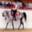
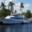
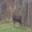
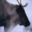
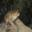

In [ ]:
df = pd.DataFrame(probs.T, texts)  # transpose for better display
df.columns = list(map(img2html, images))
HTML(df.to_html(escape=False, formatters=['{:.2%}'.format]*len(images)))

## Prepare `data/`

The subsections below are independent from each other.
Every subsection prepares a different output.

### Export model & tokenizer

Code copied/modified from the previous Colab in the blogpost
[Converting a simple JAX function](https://colab.research.google.com/github/andsteing/JaxOnTheWeb/blob/main/converting-a-simple-jax-function.ipynb)

In [ ]:
#@markdown Utility `get_tfjs_predict_fn()`
import json
import os
from string import Template

from google.colab import html, output
from IPython.display import Javascript

# We have to persistent HTML resources even if they are not explicitly passed
# to Javascript. Otherwise, they will get garbage collected.
global_refs = {}

def get_tfjs_predict_fn(model_dir, dtype='float32'):
  """Load a TF SavedModel from `model_dir` and return a prediction function.
  
  Caling the prediction function will run inference on the TFjs model in the
  browser.

  Arg:
    model_dir: Location of the TF SavedModel.
  """
  display(HTML('<script src="https://cdn.jsdelivr.net/npm/@tensorflow/tfjs@3.11.0"></script>'))

  model_path = os.path.join(model_dir, 'model.json')
  ref = html.create_resource(filepath=model_path, route=model_path)
  weight_path = os.path.join(model_dir, 'group1-shard1of1.bin')

  def add_resource(path):
    with open(path, 'rb') as f:
      return html.create_resource(content=f.read(), route=path)

  global global_refs
  global_refs.update({
      p: add_resource(p) for p in glob.glob(os.path.join(model_dir, '*.bin'))})

  def call_tfjs(x):
    """Calls the TFjs model in the browser and returns the output."""
    print(f'NOTE: Running TFJs inference for model in {model_dir}...')
    input_json = json.dumps(jax.tree_map(lambda x: x.tolist(), x))
    display(Javascript(Template('''
      async function getOutput() {
        const model = await tf.loadGraphModel('$model_url');
        const x = tf.cast(tf.tensor(JSON.parse('$inputs')), '$dtype');
        let result = model.predict(x);
        return [await result.data(), result.shape];
      }
      window.modelOutput = getOutput();
    ''').substitute(dict(model_url=ref.url, inputs=input_json, dtype=dtype))))

    output_dict, shape = output.eval_js('modelOutput')
    return np.array([*output_dict.values()]).reshape(shape).astype(np.float32)
  return call_tfjs

In [ ]:
tfjs_model_dir = f'data/models/{model_name}/tfjs'
!mkdir -p $tfjs_model_dir

In [ ]:
# (same function as `embed_tokens()` further down, but decorated differently)
def apply_fn(variables, tokens):
  zimg, ztxt, out = model.apply(variables, tokens=tokens)
  return ztxt

# pass only params that are needed by `apply_fn()`
apply_fn_variables = {
    'params': {
        'txt': variables['params']['txt'],
        't': variables['params']['t'],
    },
}

# Conversion finishes in ~90 secs.
# Last 30 secs (tfjs conversion) uses a lot of RAM.
tfjs_model_dir = tfjs_model_dir
tfjs.converters.convert_jax(
    apply_fn,
    apply_fn_variables,
    input_signatures=[tf.TensorSpec((None, model.pp.max_len), tf.int32)],
    polymorphic_shapes=[f'(b, {model.pp.max_len})'],
    model_dir=tfjs_model_dir,
)

# Note: If you get "InernalError: Failed copying ..." then that's due to missing
# memory on your accelerator; in that case best to rerun above "load model"
# section without doing any inference / calling `flax.jax_utils.replicate()`.

Writing weight file data/models/tiny/tfjs/model.json...


In [ ]:
test_prompts = ['JAX is autograd and XLA']
jax_result = apply_fn(apply_fn_variables, pp_txt(test_prompts))
jax_result.shape

(1, 1024)

In [ ]:
tfjs_predict_fn = get_tfjs_predict_fn(tfjs_model_dir, dtype='int32')
tfjs_result = tfjs_predict_fn(pp_txt(test_prompts))
tfjs_result.shape

NOTE: Running TFJs inference for model in data/models/tiny/tfjs...


<IPython.core.display.Javascript object>

(1, 1024)

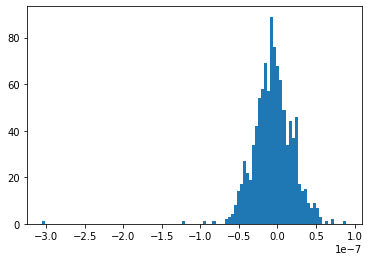

In [ ]:
plt.hist((jax_result - tfjs_result).flatten(), bins=100)
# Rather large `rtol` - might be even much larger when using TPUs.
np.testing.assert_allclose(jax_result, tfjs_result, rtol=2e-2)

At this point, we can also upload the model and then benchmark it using

https://tfjs-benchmarks.web.app/local-benchmark/

(choose `models=custom` and add URL to the exported `model.json` file)

In [ ]:
# Below code only works for sentencepiece tokenizer.
assert model.pp.tokenizer_name == 'sentencepiece'

In [ ]:
!ls -lh $tfjs_model_dir

total 34M
-rw-r--r-- 1 root root 4.0M Aug 29 09:27 group1-shard1of9.bin
-rw-r--r-- 1 root root 4.0M Aug 29 09:27 group1-shard2of9.bin
-rw-r--r-- 1 root root 4.0M Aug 29 09:27 group1-shard3of9.bin
-rw-r--r-- 1 root root 4.0M Aug 29 09:27 group1-shard4of9.bin
-rw-r--r-- 1 root root 4.0M Aug 29 09:27 group1-shard5of9.bin
-rw-r--r-- 1 root root 4.0M Aug 29 09:27 group1-shard6of9.bin
-rw-r--r-- 1 root root 4.0M Aug 29 09:27 group1-shard7of9.bin
-rw-r--r-- 1 root root 4.0M Aug 29 09:27 group1-shard8of9.bin
-rw-r--r-- 1 root root 873K Aug 29 09:27 group1-shard9of9.bin
-rw-r--r-- 1 root root 713K Aug 29 09:27 model.json


In [ ]:
from sentencepiece import sentencepiece_model_pb2

def export_sentencepiece(input_path, output_path):
  with tf.io.gfile.GFile(input_path, 'rb') as f:
    record = f.read()
  pb = sentencepiece_model_pb2.ModelProto()
  pb.ParseFromString(record)
  model_json = [
      [piece.piece, piece.score]
      for piece in pb.pieces
  ]
  with tf.io.gfile.GFile(output_path, 'w') as f:
    json.dump(model_json, f)

  # tfjs code supports both unigram & bpe model types
  tokenizer_type = pb.trainer_spec.ModelType.Name(pb.trainer_spec.model_type)
  print('exported', tokenizer_type, input_path, 'to', output_path)
  return tokenizer_type


tokenizer_type = export_sentencepiece(
    model.vocab_path, f'data/models/{model_name}/vocabulary.json')

exported BPE gs://vit_models/lit/LiT-L16Ti.model to data/models/tiny/vocabulary.json


In [ ]:
# Stores additional model information
with open(f'./data/models/{model_name}/def.json', 'w') as f:
  json.dump(dict(
      description='JAX2tfjs Blogpost Model export',
      tokenizer_type=tokenizer_type,
      temperature=np.exp(variables['params']['t'].item()),
      pad_value=pp_txt.eos_token.numpy().item(),
      max_len=model.pp.max_len,
      embedding_size=jax_result.shape[1],
  ), f, indent=2)

### Embed images

In [ ]:
variables_p = flax.jax_utils.replicate(variables)

In [ ]:
# Use @pad_shard_unpad to avoid re-compilations on last batch.
@flax.jax_utils.pad_shard_unpad
# Make code run on multiple GPU/TPU in parallel.
@jax.pmap
def embed_images(variables, images):
  zimg, ztxt, out = model.apply(variables, images=images)
  return zimg

In [ ]:
# Lower per-device batch size if code fails because of out-of-memory.
min_device_batch = 16
batch_size = jax.local_device_count() * min_device_batch

thumbs, ids, zimg = [], [], []
paths = glob.glob(f'{images_path}/*.jpg')
for step in tqdm.notebook.tqdm(range(int(np.ceil(len(paths) / batch_size)))):
  ps = paths[step*batch_size: (step+1)*batch_size]
  imgs = [np.array(PIL.Image.open(p)) for p in ps]
  imgs = pp_img(imgs)
  # Store images as seen by model in `thumbs`.
  thumbs.extend(
      PIL.Image.fromarray((127.5*(img+1)).astype('uint8')) for img in imgs)
  ids.extend(p.split('/')[-1].split('.')[0] for p in ps)
  zimg.append(embed_images(
      variables_p, imgs, min_device_batch=min_device_batch))

zimg = np.concatenate(zimg)
zimg.shape

  0%|          | 0/4 [00:00<?, ?it/s]

/usr/local/lib/python3.7/dist-packages/flax/jax_utils.py:291: FutureWarning: jax.tree_leaves is deprecated, and will be removed in a future release. Use jax.tree_util.tree_leaves instead.
  batch_sizes |= {t.shape[0] for t in jax.tree_leaves(a)}


(60, 1024)

In [ ]:
# Write image information & embeddings.

!mkdir -p data/images
with open('data/images/info.json', 'w') as f:
  json.dump([
      row.to_dict()
      for _, row in images_info.fillna('').iterrows()
  ], f, indent=2)

for id_, thumb in zip(ids, thumbs):
  thumb.save(f'data/images/{id_}.jpg')

with open(f'data/models/{model_name}/zimgs.bin', 'wb') as f:
  f.write(zimg.tobytes())
with open(f'data/models/{model_name}/zimgs.txt', 'w') as f:
  f.write('\n'.join(ids))

### Embed prompts

In [ ]:
if 'variables_p' not in globals():
  variables_p = flax.jax_utils.replicate(variables)

In [ ]:
prompts = sorted(set([
    prompt.strip()
    for cell in images_info['prompts'].values
    for prompt in cell.split(',')
    if prompt
]))
len(prompts)

292

In [ ]:
# Use @pad_shard_unpad to avoid re-compilations on last batch.
@flax.jax_utils.pad_shard_unpad
# Make code run on multiple GPU/TPU in parallel.
@jax.pmap
def embed_tokens(variables, tokens):
  zimg, ztxt, out = model.apply(variables, tokens=tokens)
  return ztxt

In [ ]:
# Lower per-device batch size if code fails with out-of-memory.
# (TPU runtime might just crash without any error message in this case!)
min_device_batch = 32
batch_size = jax.local_device_count() * min_device_batch

ztxt = []
for step in tqdm.notebook.tqdm(range(int(np.ceil(len(prompts) / batch_size)))):
  ztxt.append(embed_tokens(
      variables_p,
      pp_txt(prompts[step*batch_size: (step+1)*batch_size]),
      min_device_batch=min_device_batch))
ztxt = np.concatenate(ztxt)
ztxt.shape

  0%|          | 0/10 [00:00<?, ?it/s]

(292, 1024)

In [ ]:
# Write prompt embeddings.

with open(f'data/models/{model_name}/ztxts.bin', 'wb') as f:
  f.write(ztxt.tobytes())
with open(f'data/models/{model_name}/ztxts.txt', 'w') as f:
  f.write('\n'.join(prompts))

### Sanity check

image,best prompts
,a statue of a blue cow's headblue cow big eyecartoon cow in real lifecartoon horsesthree giraffes doing a cartwheel
,a painting on a wall of a dinosaur brushing their teetha green car and some treesgreen leaves and a monkeya green mancartoon cow in real life
,a monkey drinking coca cola zeroa monkey sitting on beacha monkey holds a telescopea monkeya monkey looking at itself in a mirror

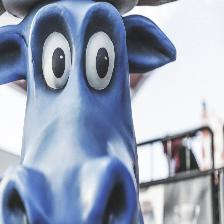
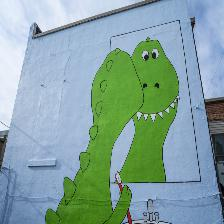
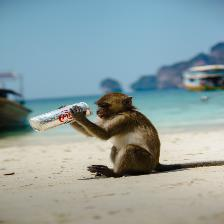

In [ ]:
HTML(pd.DataFrame([
    (img2html(thumbs[i]), '<br>'.join(np.array(prompts)[
        (-zimg[i] @ ztxt.T).argsort()[:5]]))
    for i in np.random.choice(range(len(ids)), 3, replace=False)
], columns=['image', 'best prompts']).to_html(escape=False, index=False))

## Download `data.zip`

In [ ]:
!du -hd0 data/

37M	data/


In [ ]:
# download everything as single ZIP file
!zip -rq data.zip data/
!ls -lh data.zip

import google.colab.files
google.colab.files.download('data.zip')

-rw-r--r-- 1 root root 33M Aug 29 09:28 data.zip


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>